<a href="https://colab.research.google.com/github/phycoding/COTs-Classification/blob/main/keras_retinanet_cots_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
# show images inline
%matplotlib inline

import keras
import tensorflow

# import miscellaneous modules
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
import time

import tensorflow as tf

#Clone Git Repository
!git clone "https://github.com/fizyr/keras-retinanet.git"
%cd keras-retinanet/
!python setup.py build_ext --inplace

# import keras_retinanet
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color
from keras_retinanet import models

Cloning into 'keras-retinanet'...
remote: Enumerating objects: 6209, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 6209 (delta 0), reused 0 (delta 0), pack-reused 6205
Receiving objects: 100% (6209/6209), 13.48 MiB | 23.27 MiB/s, done.
Resolving deltas: 100% (4201/4201), done.
/content/keras-retinanet
running build_ext
cythoning keras_retinanet/utils/compute_overlap.pyx to keras_retinanet/utils/compute_overlap.c
/usr/local/lib/python3.7/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/keras-retinanet/keras_retinanet/utils/compute_overlap.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'keras_retinanet.utils.compute_overlap' extension
creating build
creating build/temp.linux-x86_64-3.7
creating build/temp.linux-x86_64-3.7/keras_retinanet
creating build/temp.linux-x86_64-3.7/keras_r

In [ ]:
!mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json

api_token = {"username":"puspakmeher","key":"e2f03dea99a4e9f3b033c668045f12fa"}

import json

with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)

!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle competitions download -c tensorflow-great-barrier-reef

100% 14.2G/14.2G [01:29<00:00, 195MB/s]
100% 14.2G/14.2G [01:29<00:00, 170MB/s]


In [ ]:

!mkdir cots
!unzip "/content/Cots/tensorflow-great-barrier-reef.zip" -d "/content/cots"
!rm "/content/Cots/tensorflow-great-barrier-reef.zip"

Streaming output truncated to the last 5000 lines.
  inflating: /content/cots/train_images/video_2/4303.jpg  
  inflating: /content/cots/train_images/video_2/4304.jpg  
  inflating: /content/cots/train_images/video_2/4305.jpg  
  inflating: /content/cots/train_images/video_2/4306.jpg  
  inflating: /content/cots/train_images/video_2/4307.jpg  
  inflating: /content/cots/train_images/video_2/4308.jpg  
  inflating: /content/cots/train_images/video_2/4309.jpg  
  inflating: /content/cots/train_images/video_2/431.jpg  
  inflating: /content/cots/train_images/video_2/4310.jpg  
  inflating: /content/cots/train_images/video_2/4311.jpg  
  inflating: /content/cots/train_images/video_2/4312.jpg  
  inflating: /content/cots/train_images/video_2/4313.jpg  
  inflating: /content/cots/train_images/video_2/4314.jpg  
  inflating: /content/cots/train_images/video_2/4315.jpg  
  inflating: /content/cots/train_images/video_2/4316.jpg  
  inflating: /content/cots/train_images/video_2/4317.jpg  
  infl

# Explainatory Data Analysis

In [ ]:
!pip install -q ffmpeg-python

In [ ]:
!pip install tensorflow_addons

     |████████████████████████████████| 1.1 MB 5.2 MB/s 


In [ ]:
import warnings
warnings.filterwarnings('ignore')
import cv2
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import matplotlib.pyplot as plt
import seaborn as sns
import random
import ffmpeg
from tqdm import tqdm
import tensorflow as tf
import tensorflow_addons as tfa
import logging
from itertools import cycle

logging.disable(logging.WARNING)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 


plt.style.use('ggplot')
cm = sns.light_palette("green", as_cmap=True)
pd.option_context('display.max_colwidth', 100)
color_pal = plt.rcParams["axes.prop_cycle"].by_key()["color"]
color_cycle = cycle(plt.rcParams["axes.prop_cycle"].by_key()["color"])

ModuleNotFoundError: ignored

In [ ]:
# SEED EVERYTHING
random.seed(hash("setting random seeds") % 2**32 - 1)
np.random.seed(hash("improves reproducibility") % 2**32 - 1)

# config
class config:
    BASE_DIR = "/content/cots/train_images"

In [ ]:
img_og = plt.imread('/content/cots/train_images/video_1/9101.jpg')
img_9101 = cv2.imread('/content/cots/train_images/video_1/9101.jpg')

FileNotFoundError: ignored

In [ ]:
df = pd.read_csv('/content/cots/train.csv')
train_dir = "/content/cots/train_images"
df['image_path'] = train_dir + "/video_" + df['video_id'].astype(str) + "/" + df['video_frame'].astype(str) + ".jpg"
df.head().style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

In [ ]:
df[df.annotations.str.len() > 2].head(5).style.background_gradient(cmap=cm) # filling up the annotation column

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23501 entries, 0 to 23500
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   video_id        23501 non-null  int64 
 1   sequence        23501 non-null  int64 
 2   video_frame     23501 non-null  int64 
 3   sequence_frame  23501 non-null  int64 
 4   image_id        23501 non-null  object
 5   annotations     23501 non-null  object
 6   image_path      23501 non-null  object
dtypes: int64(4), object(3)
memory usage: 1.3+ MB


In [ ]:
df['annotations'] = df['annotations'].apply(eval)
df_train_v2 = df[df.annotations.str.len() > 0 ].reset_index(drop=True)
df_train_v2.head(5).style.background_gradient(cmap='Reds')

In [ ]:
#What is Sequence and its properties:
df_train_v2["no_of_bbox"] = df_train_v2["annotations"].apply(lambda x: len(x))
df_train_v2["sequence"].value_counts(), len(df_train_v2["sequence"].value_counts())

(8503     1100
 53708     704
 60754     654
 22643     577
 8399      564
 40258     285
 996       209
 59337     156
 45518     123
 60510     113
 17665      87
 35305      80
 15827      74
 18048      71
 29859      71
 26651      29
 45015      22
 Name: sequence, dtype: int64, 17)

In [ ]:
for i in range(3):
    print(df_train_v2["sequence"][df_train_v2["video_id"] == i].unique(), 
          df_train_v2["sequence"][df_train_v2["video_id"] == i].nunique())

In [ ]:
#Bounding box analysis in each video:
def plot_with_count(df,vid):
    names = df["bbox_typ"].to_list()
    values = df["counts"].to_list()

    N = len(names)
    menMeans = values
    ind = np.arange(N)

    plt.rcParams["figure.figsize"] = [7.00, 3.50]
    plt.rcParams["figure.autolayout"] = True
    fig, ax = plt.subplots(figsize=(15,6))

    ax.bar(ind,menMeans,width=0.4)
    plt.xticks(np.arange(0, N, step=1))
    plt.title(f"Number of bounding box VS Count of Bounding Box: Video{vid} ",fontsize=20)
    plt.xlabel('Number of bounding box', fontsize=18)
    plt.ylabel('Count', fontsize=16)

    for index,data in enumerate(menMeans):
        plt.text(x=index , y =data+1 , s=f"{data}" , fontdict=dict(fontsize=15))

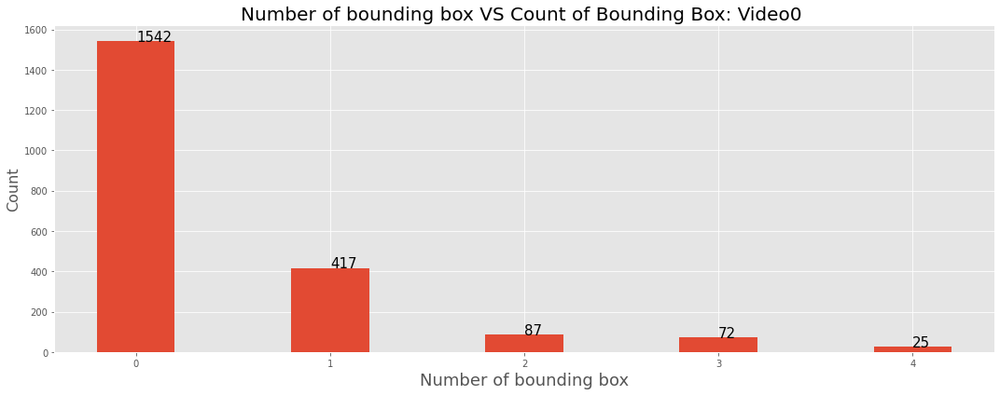

In [ ]:
vid = 0
df_vod0_bbox_cnt = df_train_v2["no_of_bbox"][df_train_v2["video_id"] == vid].value_counts().reset_index() # LEARNING .to_frame() and .reset_index()
df_vod0_bbox_cnt.columns = ['bbox_typ', 'counts']
plot_with_count(df_vod0_bbox_cnt,vid)

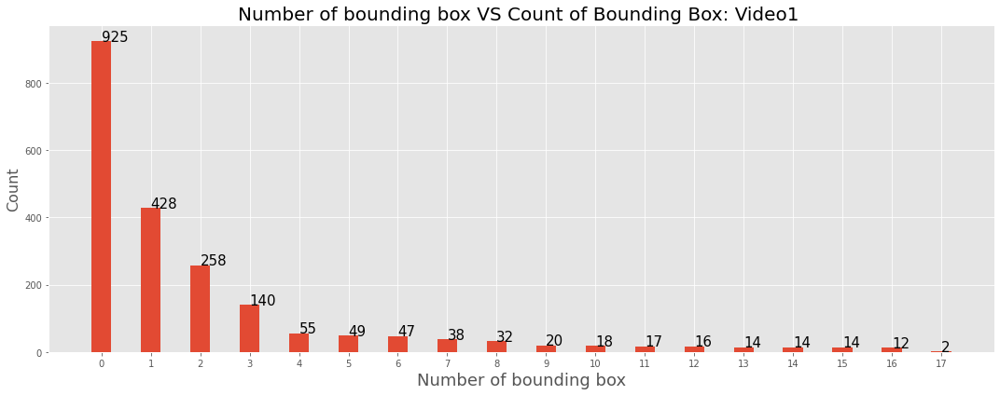

In [ ]:
vid = 1
df_vod1_bbox_cnt = df_train_v2["no_of_bbox"][df_train_v2["video_id"] == vid].value_counts().reset_index() # LEARNING .to_frame() and .reset_index()
df_vod1_bbox_cnt.columns = ['bbox_typ', 'counts']
plot_with_count(df_vod1_bbox_cnt,vid)

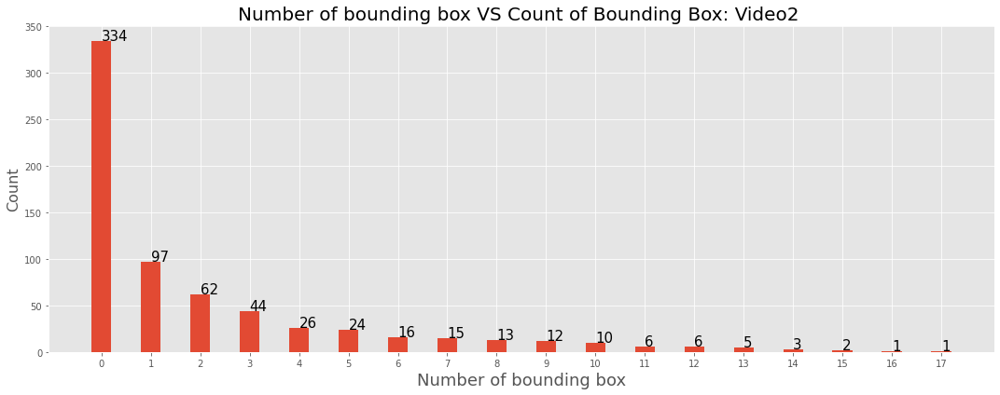

In [ ]:
vid = 2
df_vod2_bbox_cnt = df_train_v2["no_of_bbox"][df_train_v2["video_id"] == vid].value_counts().reset_index() # LEARNING .to_frame() and .reset_index()
df_vod2_bbox_cnt.columns = ['bbox_typ', 'counts']
plot_with_count(df_vod2_bbox_cnt,vid)

In [ ]:
# https://www.kaggle.com/julian3833/reef-a-cv-strategy-subsequences
df = pd.read_csv("/content/cots/train.csv")
df['annotations'] = df['annotations'].apply(eval)
df['n_annotations'] = df['annotations'].str.len()
df['has_annotations'] = df['annotations'].str.len() > 0
df['has_2_or_more_annotations'] = df['annotations'].str.len() >= 2
df['doesnt_have_annotations'] = df['annotations'].str.len() == 0
df['image_path'] = config.BASE_DIR + "video_" + df['video_id'].astype(str) + "/" + df['video_frame'].astype(str) + ".jpg"

In [ ]:
df_agg = df.groupby(["video_id", 'sequence']).agg({'sequence_frame': 'count', 'has_annotations': 'sum', 'doesnt_have_annotations': 'sum'})\
           .rename(columns={'sequence_frame': 'Total Frames', 'has_annotations': 'Frames with at least 1 object', 'doesnt_have_annotations': "Frames with no object"})
df_agg

<Figure size 864x1080 with 0 Axes>

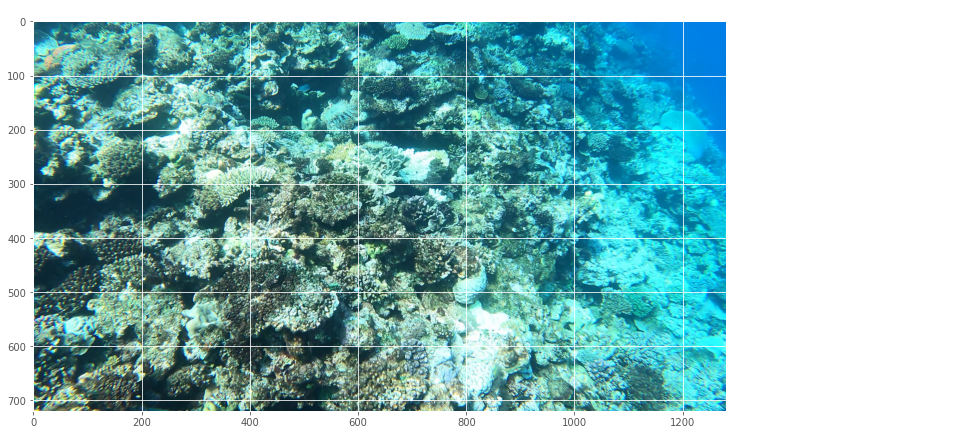

In [ ]:
plt.figure(figsize = (12,15))


plt.rcParams["figure.figsize"] = [20.00, 10.50]
plt.rcParams["figure.autolayout"] = True
fig, ax = plt.subplots(figsize=(20,6))

plt.imshow(plt.imread("/content/cots/train_images/video_0/40.jpg"));
newax = fig.add_axes([0.3,0.3,0.6,0.7], anchor='NE', zorder=1)
newax.axis('off')
plt.show();

In [ ]:
count_bbox = []
for i in df["annotations"]:
    count_bbox.append(len(i))
    
from collections import defaultdict


bbox_dict = defaultdict(int)

for val in count_bbox:
    bbox_dict[val] += 1

names = list(bbox_dict.keys())
values = list(bbox_dict.values())

N = len(list(bbox_dict.values()))
menMeans = list(bbox_dict.values())
ind = np.arange(N)

plt.rcParams["figure.figsize"] = [20.00, 10.50]
plt.rcParams["figure.autolayout"] = True
fig, ax = plt.subplots(figsize=(20,6))

ax.bar(ind,menMeans,width=0.4)
plt.xticks(np.arange(0, N, step=1))
plt.title("Number of bounding box VS Count of Bounding Box",fontsize=20)
plt.xlabel('Number of bounding box', fontsize=18)
plt.ylabel('Count', fontsize=16)
for index,data in enumerate(menMeans):
    plt.text(x=index , y =data+1 , s=f"{data}" , fontdict=dict(fontsize=20))



plt.show()

# Histogram Equalization
This is a method of contrast adjustment based on the image's histogram.



In [ ]:
def he_hsv(img_demo):
    img_hsv = cv2.cvtColor(img_demo, cv2.COLOR_RGB2HSV)

    # Histogram equalisation on the V-channel
    img_hsv[:, :, 2] = cv2.equalizeHist(img_hsv[:, :, 2])

    # convert image back from HSV to RGB
    image_hsv = cv2.cvtColor(img_hsv, cv2.COLOR_HSV2RGB)
    
    return image_hsv

In [ ]:
def plot_img(img_dir,num_items,func,mode):
    img_list = random.sample(os.listdir(img_dir), num_items)

    for i in range(len(img_list)):
        full_path = img_dir + '/' + img_list[i]
        img_temp1 = plt.imread(full_path)
        img_temp_cv = cv2.imread(full_path)
        plt.figure(figsize=(20,15))
        plt.subplot(1,2,1)
        plt.imshow(img_temp1);
        plt.subplot(1,2,2)
        if mode == 'plt':
            plt.imshow(func(img_temp1));
        elif mode == 'cv2':
            plt.imshow(func(img_temp_cv));

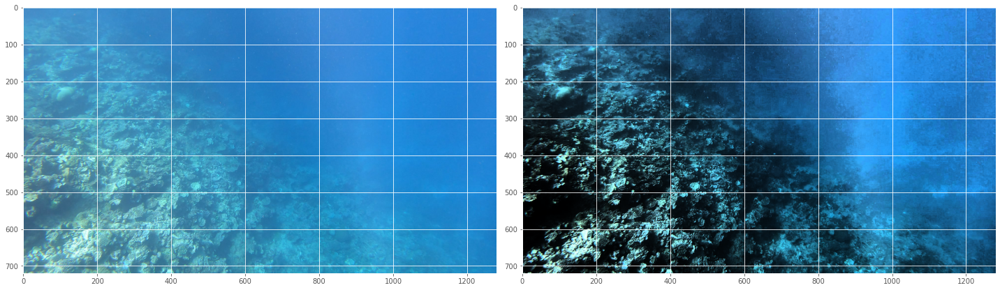

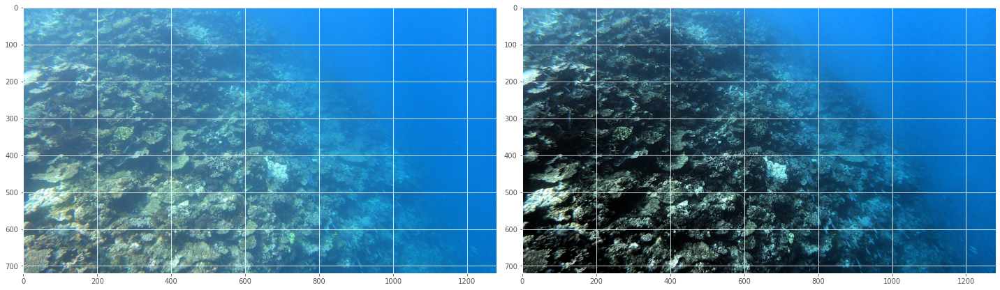

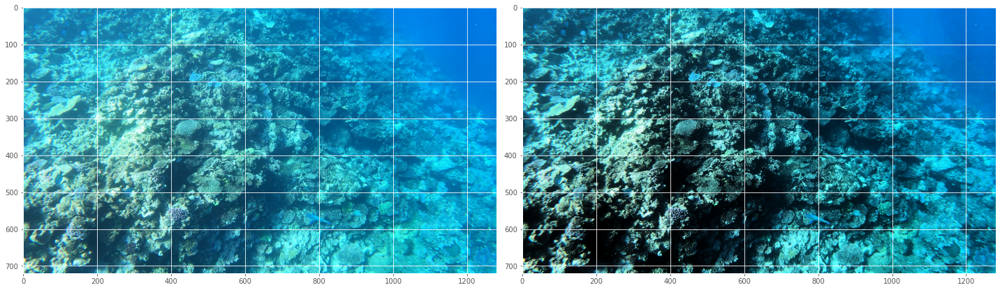

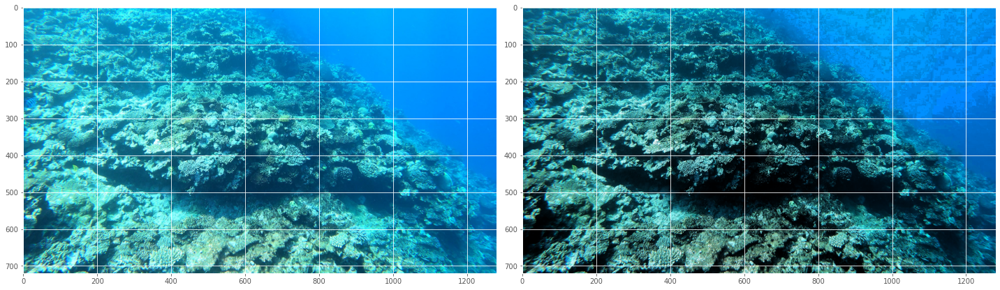

In [ ]:
vid_0_dir = "/content/cots/train_images/video_0"
num_items1 = 4
plot_img(vid_0_dir,num_items1,he_hsv,"plt")

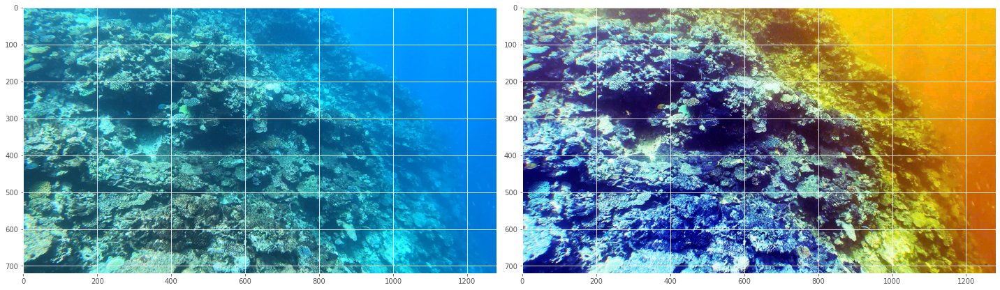

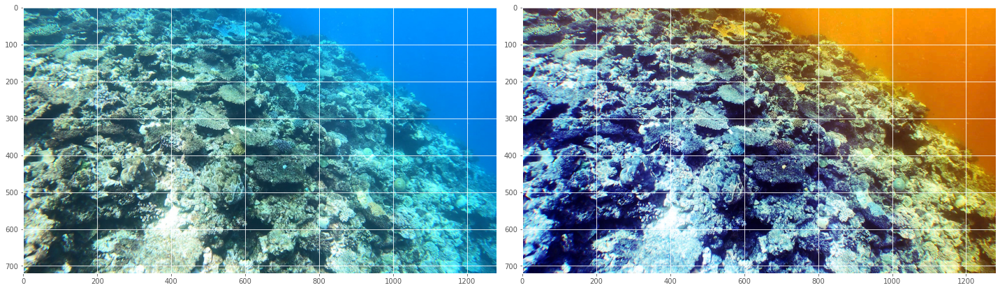

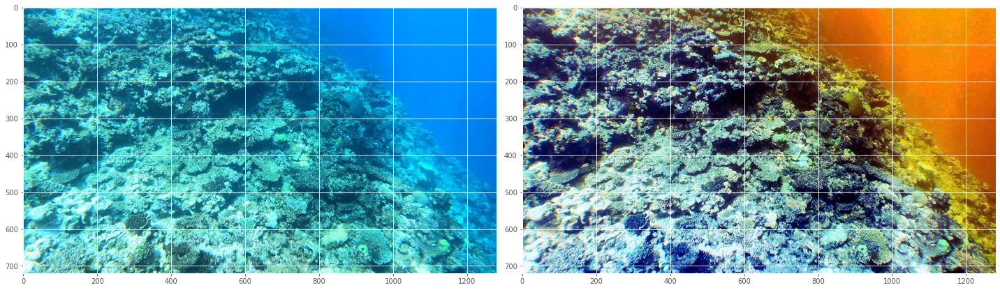

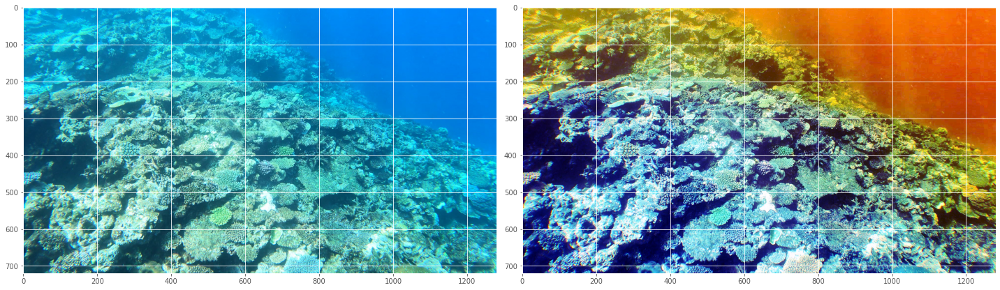

In [ ]:
#Applying Histogram Equalizers in each channel
def RecoverHE(sceneRadiance):
    for i in range(3):
        sceneRadiance[:, :, i] =  cv2.equalizeHist(sceneRadiance[:, :, i])
    return sceneRadiance

vid_0_dir = "/content/cots/train_images/video_0"
num_items1 = 4
plot_img(vid_0_dir,num_items1,RecoverHE,"cv2")

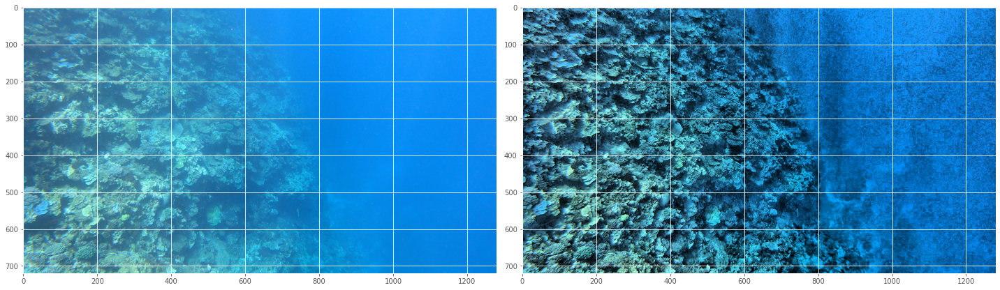

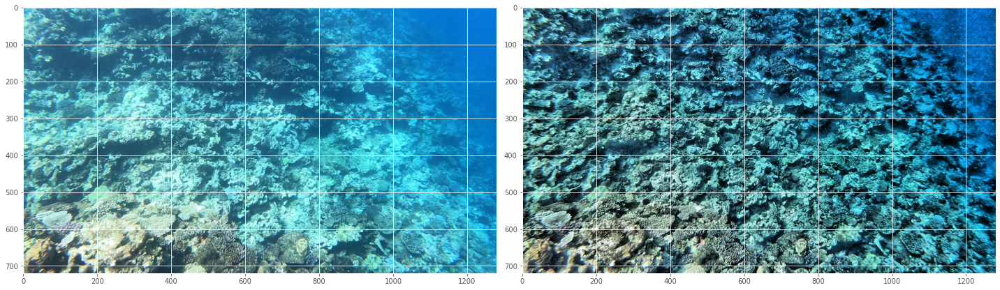

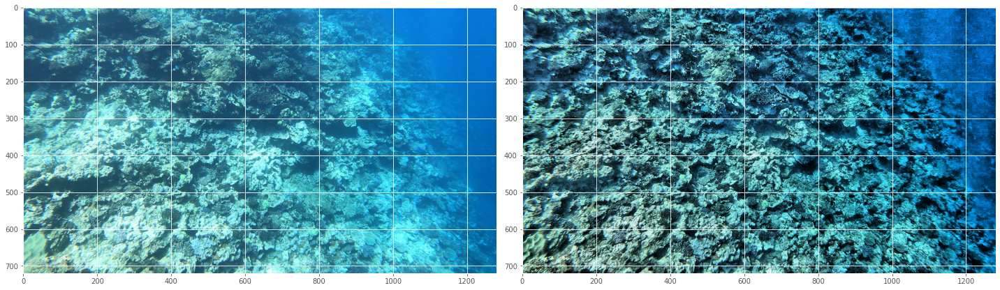

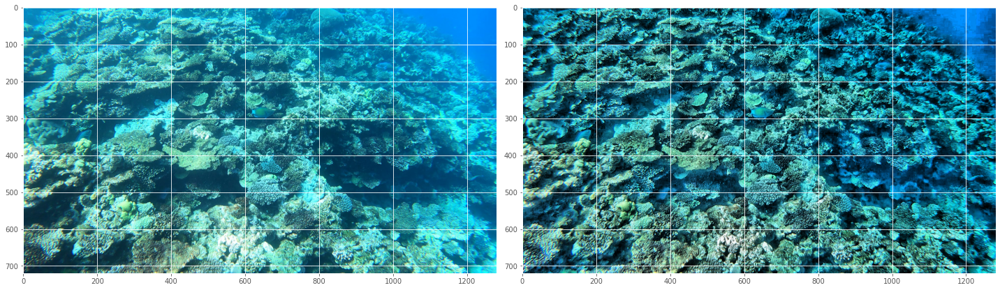

In [ ]:
#Clahe Enhanced image
def clahe_hsv(img):
    hsv_img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    h, s, v = hsv_img[:,:,0], hsv_img[:,:,1], hsv_img[:,:,2]
    clahe = cv2.createCLAHE(clipLimit = 15.0, tileGridSize = (20,20))
    v = clahe.apply(v)

    hsv_img = np.dstack((h,s,v))

    rgb = cv2.cvtColor(hsv_img, cv2.COLOR_HSV2RGB)
    
    return rgb


vid_0_dir = "/content/cots/train_images/video_0"
num_items1 = 4
plot_img(vid_0_dir,num_items1,clahe_hsv,"cv2")

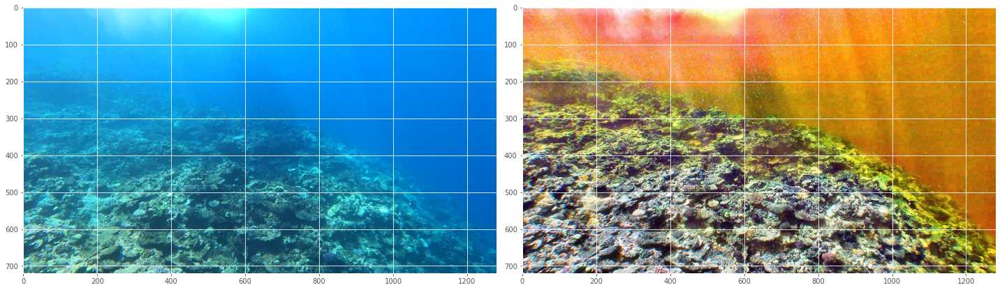

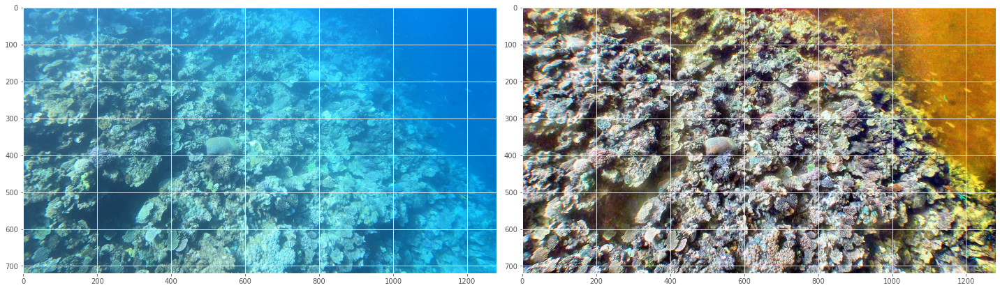

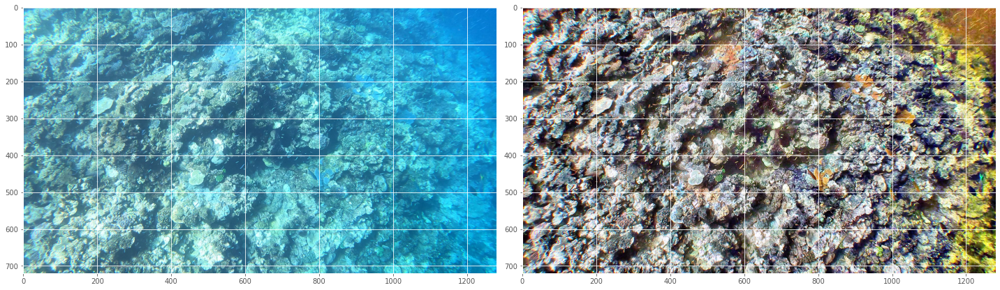

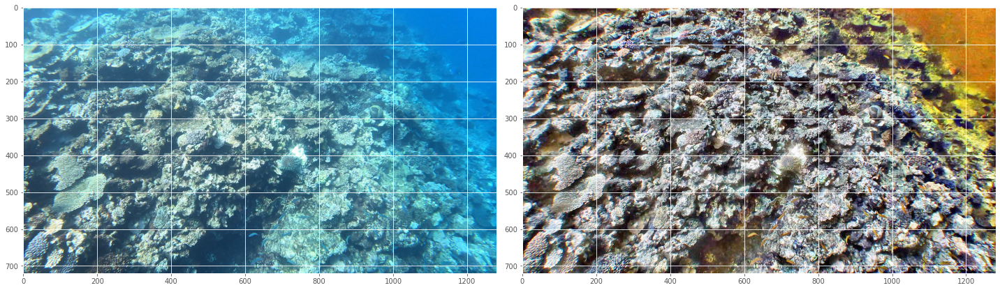

In [ ]:
# CLAHE: with repo code:
def RecoverCLAHE(sceneRadiance):
    clahe = cv2.createCLAHE(clipLimit=7, tileGridSize=(14, 14))
    for i in range(3):

        
        sceneRadiance[:, :, i] = clahe.apply((sceneRadiance[:, :, i]))


    return sceneRadiance

vid_0_dir = "/content/cots/train_images/video_0"
num_items1 = 4
plot_img(vid_0_dir,num_items1,RecoverCLAHE,"cv2")

From the image, it seems like all the rocks, plants, and other underwater objects are on the ground and sunlight falling upon them, not inside a sea.

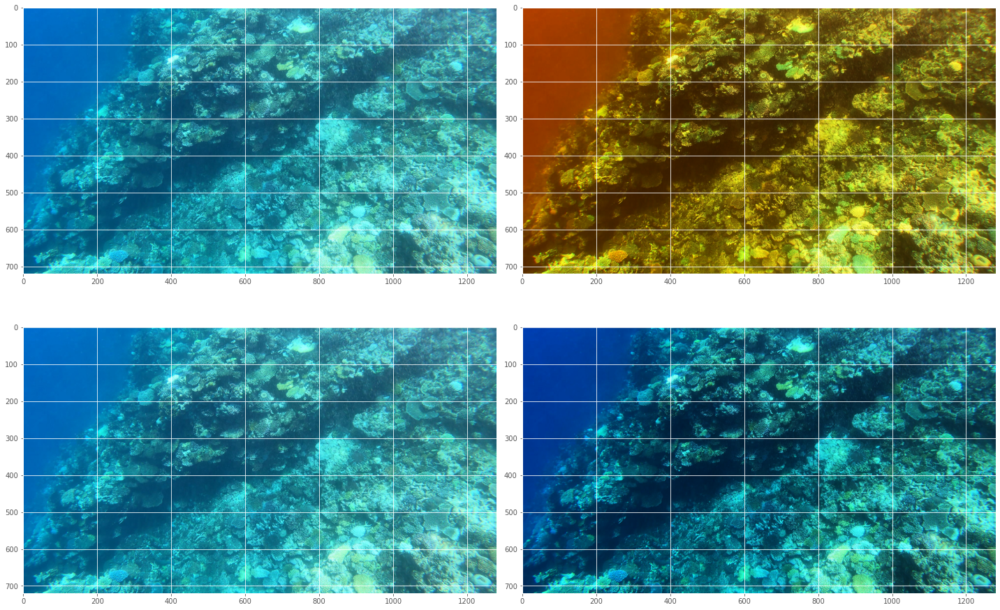

In [ ]:
def gamma_enhancement(image,gamma):
    R = 255.0
    return (R * np.power(image.astype(np.uint32)/R, gamma)).astype(np.uint8)

plt.figure(figsize=(20,15))
plt.subplot(2,2,1)
plt.imshow(img_og);
plt.subplot(2,2,2)
plt.imshow(gamma_enhancement(img_9101,1/0.6))

plt.subplot(2,2,3)
plt.imshow(img_og);
plt.subplot(2,2,4)
plt.imshow(gamma_enhancement(img_og,1/0.6))

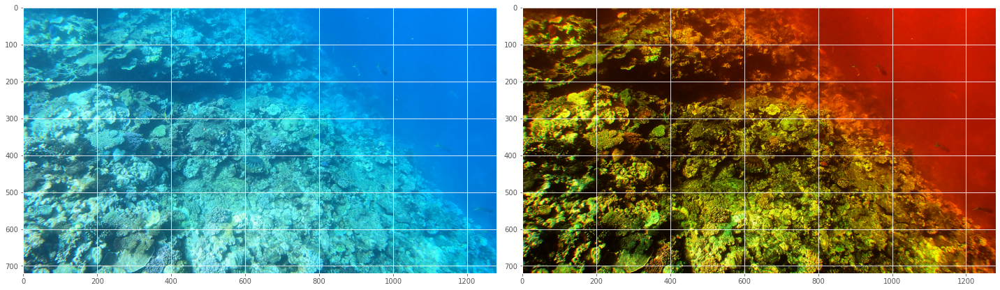

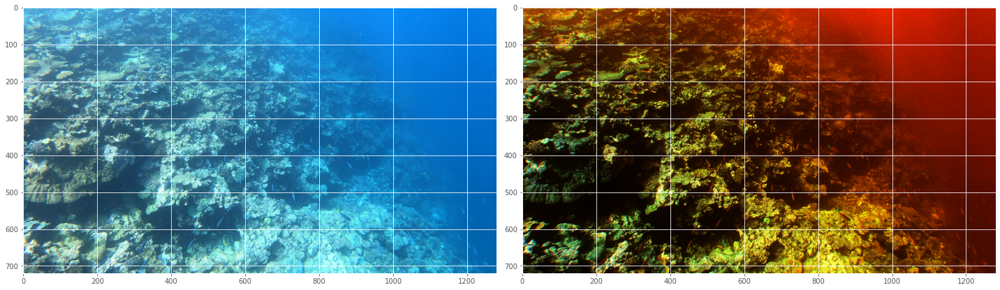

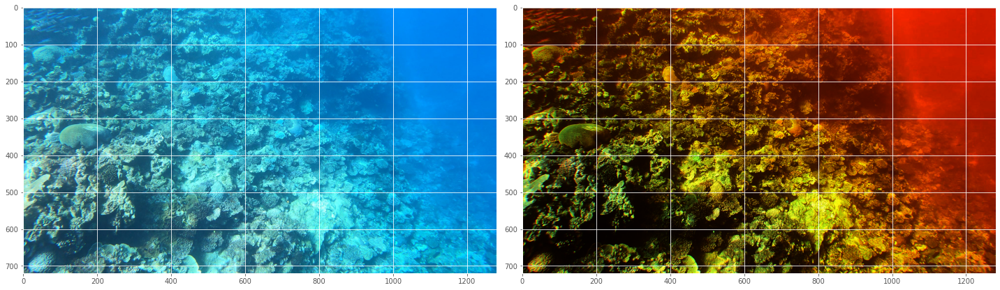

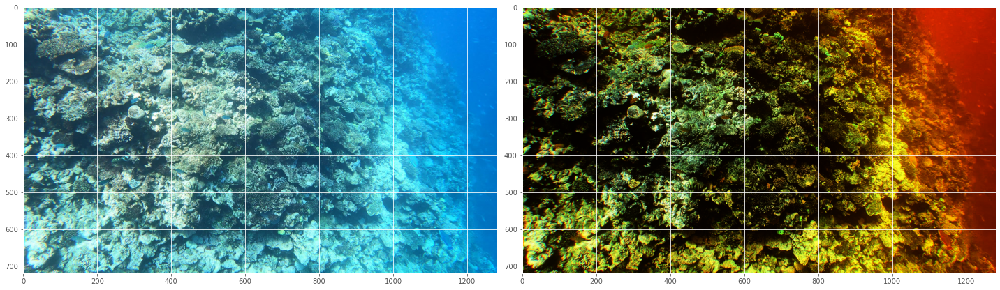

In [ ]:
#Gc with Repo code
def RecoverGC(sceneRadiance):
    sceneRadiance = sceneRadiance/255.0
    
    for i in range(3):
        sceneRadiance[:, :, i] =  np.power(sceneRadiance[:, :, i] / float(np.max(sceneRadiance[:, :, i])), 3.2)
    sceneRadiance = np.clip(sceneRadiance*255, 0, 255)
    sceneRadiance = np.uint8(sceneRadiance)
    return sceneRadiance

vid_0_dir = "/content/cots/train_images/video_0"
num_items1 = 4
plot_img(vid_0_dir,num_items1,RecoverGC,"cv2")

#Visualizing data using Fiftyone Tool for interactive visualization

In [ ]:
from ast import literal_eval
import pandas as pd
from tqdm.notebook import tqdm

TRAIN_PATH = '/content/cots/train_images'
N_SAMP = 6000

df = pd.read_csv('/content/cots/train.csv')

df['is_valid'] = df['video_id'] == 2
df['annotations'] = df['annotations'].apply(literal_eval)
df['path'] = df.apply(lambda row: f"{TRAIN_PATH}/video_{row['video_id']}/{row['video_frame']}.jpg", axis = 1)

df.tail()

In [ ]:
def coco(df):
    
    annotion_id = 0
    images = []
    annotations = []

    categories = [{'id': 0, 'name': 'cots'}]

    for i, row in tqdm(df.iterrows(), total = len(df)):

        images.append({
            "id": i,
            "file_name": f"{row['image_id']}.jpg",
            "height": 720,
            "width": 1280,
        })
        for bbox in row['annotations']:
            annotations.append({
                "id": annotion_id,
                "image_id": i,
                "category_id": 0,
                "bbox": list(bbox.values()),
                "area": bbox['width'] * bbox['height'],
                "segmentation": [],
                "iscrowd": 0
            })
            annotion_id += 1

    json_file = {'categories':categories, 'images':images, 'annotations':annotations}
    return json_file

In [ ]:
json_train = coco(df[~df['is_valid']])
json_valid = coco(df[ df['is_valid']])

  0%|          | 0/14940 [00:00<?, ?it/s]

  0%|          | 0/8561 [00:00<?, ?it/s]

In [ ]:
#creating 2 json file and dumping train and valid file into it.
import json

with open('/content/cots/train.json', 'w', encoding='utf-8') as f:
    json.dump(json_train, f, ensure_ascii=True, indent=4)
    
with open('/content/cots/valid.json', 'w', encoding='utf-8') as f:
    json.dump(json_valid, f, ensure_ascii=True, indent=4)

In [ ]:
# Making 2 directories train2017 and test 2017
import os
os.makedirs('/content/cots/train2017', exist_ok=True)
os.makedirs('/content/cots/val2017', exist_ok=True)

In [ ]:
import shutil
for i, row in tqdm(df.iterrows(), total = len(df)):
    base_dir = 'val2017' if row['is_valid'] else 'train2017'
    fname = f"{row['image_id']}.jpg"
    shutil.copyfile(row['path'], f"/content/cots/{base_dir}/{fname}")

  0%|          | 0/23501 [00:00<?, ?it/s]

In [ ]:
import fiftyone as fo

In [ ]:
# Load COCO formatted dataset
coco_dataset = fo.Dataset.from_dir(
    dataset_type=fo.types.COCODetectionDataset,
    data_path= "/content/cots/train2017",
    labels_path="/content/cots/train.json",
    include_id = True
)

# Verify that the class list for our dataset was imported
print(coco_dataset.default_classes)  # ['airplane', 'apple', ...]

print(coco_dataset)

 100% |█████████████| 14940/14940 [22.7s elapsed, 0s remaining, 1.1K samples/s]       
['cots']
Name:        2022.04.14.03.11.09
Media type:  image
Num samples: 14940
Persistent:  False
Tags:        []
Sample fields:
    id:         fiftyone.core.fields.ObjectIdField
    filepath:   fiftyone.core.fields.StringField
    tags:       fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:   fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    detections: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    coco_id:    fiftyone.core.fields.IntField


In [ ]:
!sudo apt install libcurl4 openssl

Reading package lists... Done
Building dependency tree       
Reading state information... Done
libcurl4 is already the newest version (7.58.0-2ubuntu3.16).
The following packages will be upgraded:
  openssl
1 upgraded, 0 newly installed, 0 to remove and 38 not upgraded.
Need to get 614 kB of archives.
After this operation, 1,024 B of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic-updates/main amd64 openssl amd64 1.1.1-1ubuntu2.1~18.04.15 [614 kB]
Fetched 614 kB in 1s (659 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
(Reading database ... 155455 fil

In [ ]:
!pip install fiftyone==0.14.4

     |████████████████████████████████| 1.3 MB 5.4 MB/s 
     |████████████████████████████████| 132 kB 50.4 MB/s 
     |████████████████████████████████| 79.9 MB 125 kB/s 
     |████████████████████████████████| 564 kB 49.3 MB/s 
     |████████████████████████████████| 106 kB 47.4 MB/s 
     |████████████████████████████████| 226 kB 44.7 MB/s 
     |████████████████████████████████| 13.2 MB 36.8 MB/s 
     |████████████████████████████████| 508 kB 36.0 MB/s 
     |████████████████████████████████| 645 kB 46.9 MB/s 
     |████████████████████████████████| 55 kB 3.4 MB/s 
     |████████████████████████████████| 47.8 MB 1.7 MB/s 
     |████████████████████████████████| 29.2 MB 1.4 MB/s 
     |████████████████████████████████| 84 kB 3.0 MB/s 
     |████████████████████████████████| 68 kB 6.8 MB/s 
     |████████████████████████████████| 79 kB 7.8 MB/s 
     |████████████████████████████████| 54 kB 3.3 MB/s 
     |████████████████████████████████| 77 kB 6.6 MB/s 
     |████████████████████

In [ ]:
!pip uninstall opencv-python-headless==4.5.5.62 
!pip install opencv-python-headless==4.1.2.30

Found existing installation: opencv-python-headless 4.5.5.64
Uninstalling opencv-python-headless-4.5.5.64:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/cv2/*
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless-4.5.5.64.dist-info/*
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libavcodec-65fa80df.so.58.134.100
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libavformat-8ef5c7db.so.58.76.100
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libavutil-9c768859.so.56.70.100
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libbz2-a273e504.so.1.0.6
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libcrypto-09fe7800.so.1.1
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libgfortran-91cc3cb1.so.3.0.0
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libopenblas-r0-f650aae0.3.3.so
    /usr/local/lib/python3.7/dis

In [ ]:
fo.launch_app(coco_dataset)

In [ ]:
import pandas as pd
df_train = pd.read_csv("/content/cots/train.csv")

df_train=df_train.loc[df_train["annotations"].astype(str) != "[]"]
df_train['annotations'] = df_train['annotations'].apply(eval)

df_train['image_path'] = "/content/cots/train_images/video_" + df_train['video_id'].astype(str) + "/" + df_train['video_frame'].astype(str) + ".jpg"
df_extrain=df_train.explode('annotations') # Single annotation per row
df_extrain.reset_index(inplace=True)
df_extrain.head()

In [ ]:
df_extrain_main=pd.DataFrame(pd.json_normalize(df_extrain['annotations']), columns=['x', 'y', 'width', 'height']).join(df_extrain)
df_extrain_main['class']='Fish'
df_extrain_main=df_extrain_main[['image_path','x','y','width','height','class','video_id','video_frame']]
df_extrain_main.head(10)

,image_path,x,y,width,height,class,video_id,video_frame
0,/content/cots/train_images/video_0/16.jpg,559,213,50,32,Fish,0,16
1,/content/cots/train_images/video_0/17.jpg,558,213,50,32,Fish,0,17
2,/content/cots/train_images/video_0/18.jpg,557,213,50,32,Fish,0,18
3,/content/cots/train_images/video_0/19.jpg,556,214,50,32,Fish,0,19
4,/content/cots/train_images/video_0/20.jpg,555,214,50,32,Fish,0,20
5,/content/cots/train_images/video_0/21.jpg,550,214,50,32,Fish,0,21
6,/content/cots/train_images/video_0/22.jpg,538,209,56,47,Fish,0,22
7,/content/cots/train_images/video_0/23.jpg,535,207,58,48,Fish,0,23
8,/content/cots/train_images/video_0/24.jpg,532,205,59,49,Fish,0,24
9,/content/cots/train_images/video_0/25.jpg,529,200,61,50,Fish,0,25


In [ ]:
!pip install --upgrade git+https://github.com/broadinstitute/keras-resnet
import keras
import keras_resnet
import urllib.request
PRETRAINED_MODEL = '/content/keras-retinanet/snapshots/_pretrained_model.h5'
#### OPTION 1: DOWNLOAD INITIAL PRETRAINED MODEL FROM FIZYR ####
URL_MODEL = 'https://github.com/fizyr/keras-retinanet/releases/download/0.5.1/resnet50_coco_best_v2.1.0.h5'
urllib.request.urlretrieve(URL_MODEL, PRETRAINED_MODEL)
print('Downloaded pretrained model to ' + PRETRAINED_MODEL)

  Cloning https://github.com/broadinstitute/keras-resnet to /tmp/pip-req-build-lrfxjvtu
  Running command git clone -q https://github.com/broadinstitute/keras-resnet /tmp/pip-req-build-lrfxjvtu
  Created wheel for keras-resnet: filename=keras_resnet-0.2.0-py2.py3-none-any.whl size=22164 sha256=ab0331020b5fcea3eebdcbc4634e39e54e17a0eda26803e21b81763b35d1f51f
  Stored in directory: /tmp/pip-ephem-wheel-cache-9fiz6t9h/wheels/f8/b9/f8/64a22c5e939a33ab49bffa0c96b23be2e66f84693b17ff512b
Successfully built keras-resnet
Downloaded pretrained model to /content/keras-retinanet/snapshots/_pretrained_model.h5


In [ ]:
from PIL import Image
import io

In [ ]:
def create_tf_example(rowss,data_df):
    """Create a tf.Example entry for a given training image."""
    full_path = os.path.join(rowss.image_path)
    with tf.io.gfile.GFile(full_path, 'rb') as fid:
        encoded_jpg = fid.read()
    encoded_jpg_io = io.BytesIO(encoded_jpg)
    image = Image.open(encoded_jpg_io)
    if image.format != 'JPEG':
        raise ValueError('Image format not JPEG')

    height = image.size[1] # Image height
    width = image.size[0] # Image width
    #print(width,height)
    filename = f'{rowss.video_id}:{rowss.video_frame}'.encode('utf8') # Unique id of the image.
    encoded_image_data = None # Encoded image bytes
    image_format = 'jpeg'.encode('utf8') # b'jpeg' or b'png'

    xmins = [] 
    xmaxs = [] 
    ymins = [] 
    ymaxs = [] 
    
    # Convert ---> [xmin,ymin,width,height] to [xmins,xmaxs,ymins,ymaxs]
    xmin = rowss['x']
    xmax = rowss['x']+rowss['width']
    ymin = rowss['y']
    ymax = rowss['y']+rowss['height']
    

    #main_data.append((rowss['image_path'],xmins,xmaxs,ymins,ymaxs))
    return rowss['image_path'],xmin,ymin,xmax,ymax

In [ ]:
import tensorflow as tf
import contextlib2
import IPython
import numpy as np
import os
import pathlib
import sys
import time

tf_example1=[]

from PIL import Image, ImageDraw

In [ ]:
for index, row in df_extrain_main.iterrows():
            if index % 1000 == 0:
                print('Processed {0} images.'.format(index))
            image_path,xmins,ymins,xmaxs,ymaxs=create_tf_example(row,df_extrain_main)
            #print(image_path,xmins,xmaxs,ymins,ymaxs)
            df_extrain_main.loc[index,'image_path']=image_path
            df_extrain_main.loc[index,'x']=xmins
            df_extrain_main.loc[index,'y']=ymins
            df_extrain_main.loc[index,'width']=xmaxs
            df_extrain_main.loc[index,'height']=ymaxs

#Creating CSV for training

In [ ]:
classes=pd.DataFrame([{'class':'Fish','label':0}])
classes.to_csv("classes.csv",index=False,header=False)  # This CSV will be use in training

df_extrain_main['class']='Fish'
df_extrain_main[['image_path','x','y','width','height','class']].to_csv("annotation.csv",index=False,header=False)

# Model Building and training

In [ ]:
!/content/keras-retinanet/keras_retinanet/bin/train.py --freeze-backbone --random-transform --weights {PRETRAINED_MODEL} --batch-size 1 --steps 500 --epochs 20 csv annotation.csv classes.csv

Creating model, this may take a second...
2022-04-16 13:53:35.480354: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)
Model: "retinanet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1 (Conv2D)                 (No

In [ ]:
from google.colab import files
files.download("/content/keras-retinanet/snapshots/resnet50_csv_03.h5")

FileNotFoundError: ignored

In [ ]:
model_path = os.path.join('snapshots', sorted(os.listdir('snapshots'), reverse=True)[0])
#print(model_path)

# load retinanet model
model = models.load_model(model_path, backbone_name='resnet50')  ## Use backbone as resnet50
model = models.convert_model(model)

# load label to names mapping for visualization purposes
labels_to_names = pd.read_csv('classes.csv',header=None).T.loc[0].to_dict()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: ignored

# New section

In [ ]:
THRES_SCORE = 0.25  # Set Score Threshold Value

def df_plot_orinal(drawOG,img_path,df):
    df=df[df['image_path']==img_path]
    for i,r in df.iterrows():
        cv2.rectangle(drawOG, (r['x'], r['y']), (r['width'], r['height']), (255,0,0),2)
    

def img_inference(img_path):
  image = read_image_bgr(img_path)

  # copy to draw on
  draw = image.copy()
  draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)
  drawOG = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  # preprocess image for network
  image = preprocess_image(image)
  image, scale = resize_image(image)
  # process image
  start = time.time()
  boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
  df_plot_orinal(drawOG,img_path,df_extrain_main)
  # correct for image scale
  boxes /= scale
  # visualize detections
  for box, score, label in zip(boxes[0], scores[0], labels[0]):
      # scores are sorted so we can break
      #print(score)
      if score < THRES_SCORE:
          continue
      color = label_color(label)
      b = box.astype(int)
      draw_box(draw, b, color=color)
      caption = "{} {:.3f}%".format(labels_to_names[label], score*100)
  
  fig = plt.figure(figsize=(20, 20))
  ax1=fig.add_subplot(1, 2, 1)
  plt.imshow(draw)
  ax2=fig.add_subplot(1, 2, 2)
  plt.imshow(drawOG)

  ax1.title.set_text('Predicted')
  ax2.title.set_text('Actual')
  plt.show()

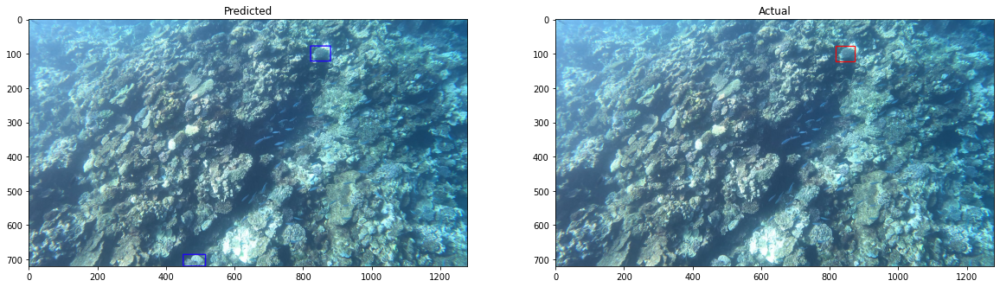

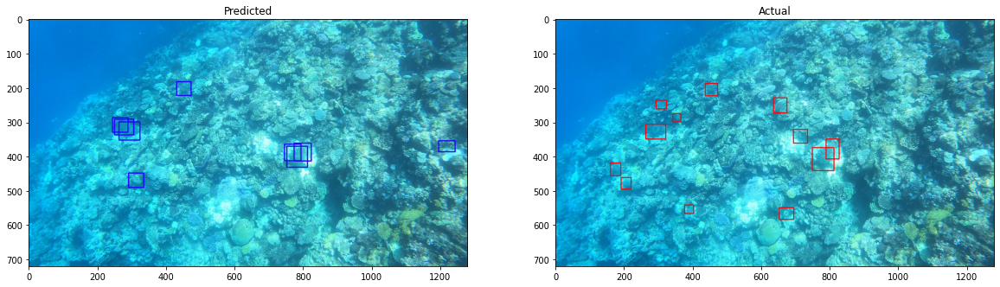

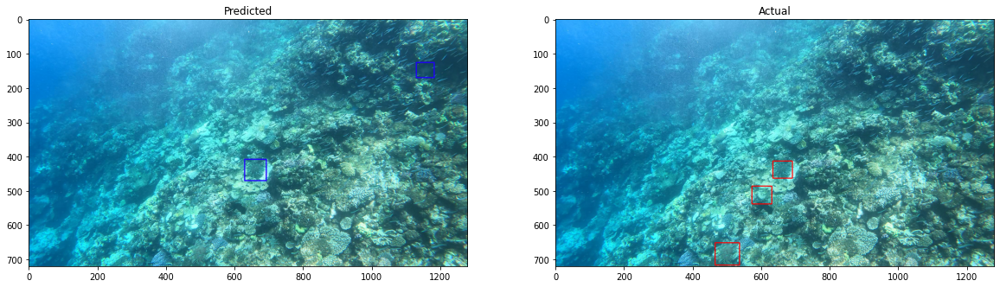

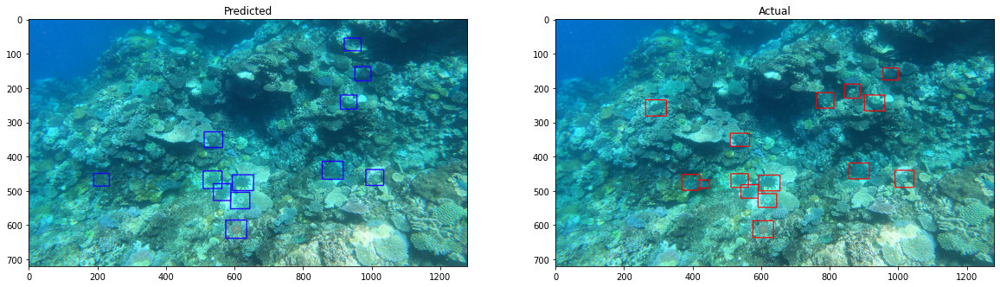

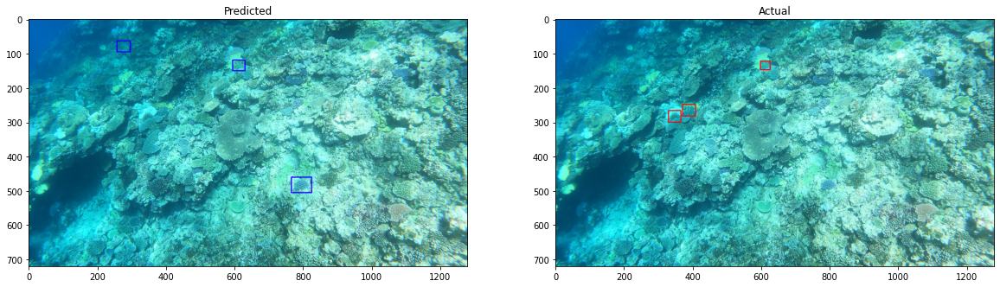

In [ ]:
data=df_extrain_main.sample(n=5)  #Predict on Random 5 Image 
for i,r in data.iterrows():
    img_inference(r['image_path'])